## SHOW RESULT FROM MONGO

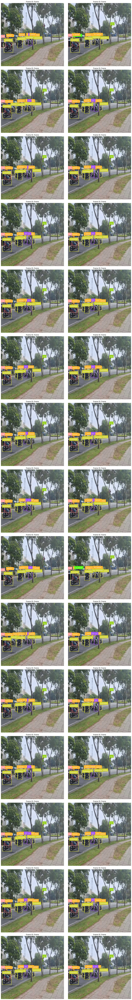

In [1]:

import cv2
import base64
from pymongo import MongoClient
import matplotlib.pyplot as plt
import numpy as np
client = MongoClient('localhost', 27017)
db = client['traffic_violation']
collection = db['violations']

def plot_all_images_from_mongodb(number_of_images=30):
    cursor = collection.find().limit(number_of_images)
    num_rows = (number_of_images + 1) // 2
    fig, axes = plt.subplots(num_rows, 2, figsize=(15, num_rows * 7))
    for i, document in enumerate(cursor):
        frame_id = document['frame_id']
        frame_base64 = document['frame']
        frame_bytes = base64.b64decode(frame_base64)
        np_arr = np.frombuffer(frame_bytes, np.uint8)
        frame = cv2.imdecode(np_arr, cv2.IMREAD_COLOR)
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        row, col = divmod(i, 2)
        axes[row, col].imshow(frame)
        axes[row, col].set_title(f'Frame ID: {frame_id}')
        axes[row, col].axis('off')
    
    for j in range(i + 1, num_rows * 2):
        row, col = divmod(j, 2)
        axes[row, col].axis('off')
    
    plt.tight_layout()
    plt.show()

plot_all_images_from_mongodb()
